# SDXL Text-to-Image 광고 생성 테스트

**목표:** Stable Diffusion XL을 사용한 소상공인 광고 이미지 생성 기본 환경 구축

**주요 기능:**
- Hugging Face Diffusers 라이브러리 사용
- GPU 가속 (CUDA)
- 파인튜닝 가능한 구조

## 1. 환경 설정 확인

In [1]:
import torch
import sys

print("="*60)
print("🔧 시스템 환경 체크")
print("="*60)
print(f"🐍 Python: {sys.version.split()[0]}")
print(f"🔥 PyTorch: {torch.__version__}")
print(f"💾 CUDA 사용 가능: {torch.cuda.is_available()}")

if torch.cuda.is_available():
    print(f"🎮 GPU: {torch.cuda.get_device_name(0)}")
    print(f"💾 GPU 메모리: {torch.cuda.get_device_properties(0).total_memory / 1024**3:.1f} GB")
    print(f"📊 CUDA Version: {torch.version.cuda}")
else:
    print("⚠️  GPU를 사용할 수 없습니다. CPU로 실행됩니다 (매우 느림).")

print("="*60)

🔧 시스템 환경 체크
🐍 Python: 3.13.7
🔥 PyTorch: 2.9.0+cu128
💾 CUDA 사용 가능: True
🎮 GPU: NVIDIA L4
💾 GPU 메모리: 22.0 GB
📊 CUDA Version: 12.8


## 2. 필요한 라이브러리 Import

In [2]:
from diffusers import StableDiffusionXLPipeline
from datetime import datetime
import os

print("✅ 라이브러리 Import 완료")

✅ 라이브러리 Import 완료


## 3. SDXL 이미지 생성기 클래스

In [3]:
class SDXLGenerator:
    """
    SDXL 이미지 생성기 (로컬 GPU 사용)
    파인튜닝 가능한 환경
    """

    def __init__(self, model_id: str = "stabilityai/stable-diffusion-xl-base-1.0"):
        """
        SDXL 모델 초기화

        Args:
            model_id: Hugging Face 모델 ID
        """
        print("🔄 SDXL 모델 로딩 중...")

        # GPU 사용 가능 여부 확인
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        print(f"📱 사용 디바이스: {self.device}")

        if self.device == "cpu":
            print("⚠️  GPU가 없습니다. 생성 속도가 매우 느릴 수 있습니다.")
        else:
            print(f"🎮 GPU: {torch.cuda.get_device_name(0)}")
            print(f"💾 GPU 메모리: {torch.cuda.get_device_properties(0).total_memory / 1024**3:.1f} GB")

        # SDXL 파이프라인 로드
        self.pipe = StableDiffusionXLPipeline.from_pretrained(
            model_id,
            torch_dtype=torch.float16 if self.device == "cuda" else torch.float32,
            use_safetensors=True,
            variant="fp16" if self.device == "cuda" else None
        )
        self.pipe.to(self.device)

        # 메모리 최적화 (GPU 사용시)
        if self.device == "cuda":
            self.pipe.enable_attention_slicing()

        print("✅ 모델 로딩 완료!\n")

    def generate(
        self,
        prompt: str,
        negative_prompt: str = "ugly, blurry, low quality, distorted, watermark, text artifacts",
        num_inference_steps: int = 30,
        guidance_scale: float = 7.5,
        width: int = 1024,
        height: int = 1280,
        output_dir: str = "../outputs"
    ):
        """
        이미지 생성

        Args:
            prompt: 생성할 이미지 설명
            negative_prompt: 생성하지 않을 요소
            num_inference_steps: 생성 스텝 수 (높을수록 품질↑, 시간↑)
            guidance_scale: 프롬프트 따르는 정도 (7-9 권장)
            width, height: 이미지 크기
            output_dir: 저장 디렉토리
        """
        os.makedirs(output_dir, exist_ok=True)

        print(f"🎨 이미지 생성 중...")
        print(f"📝 프롬프트: {prompt}")
        print(f"⚙️  설정: steps={num_inference_steps}, guidance={guidance_scale}")
        print(f"📐 크기: {width}x{height}\n")

        # 이미지 생성
        image = self.pipe(
            prompt=prompt,
            negative_prompt=negative_prompt,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            width=width,
            height=height
        ).images[0]

        # 저장
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        filename = f"{output_dir}/sdxl_{timestamp}.png"
        image.save(filename)

        print(f"✅ 생성 완료!")
        print(f"📁 저장 위치: {filename}\n")

        return image, filename

## 4. 모델 초기화

⚠️ **주의:** 최초 실행시 모델 다운로드로 약 5-10분 소요될 수 있습니다.

In [4]:
# 모델 초기화 (최초 1회만)
generator = SDXLGenerator()

🔄 SDXL 모델 로딩 중...
📱 사용 디바이스: cuda
🎮 GPU: NVIDIA L4
💾 GPU 메모리: 22.0 GB


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


✅ 모델 로딩 완료!



## 5. 테스트 1: 단일 이미지 생성

🎨 이미지 생성 중...
📝 프롬프트: A modern Korean cafe interior with iced coffee without whipping cream on a wooden table, natural lighting, warm atmosphere, professional photography, high quality, 4k
⚙️  설정: steps=25, guidance=7.5
📐 크기: 1024x1280



  0%|          | 0/25 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_082909.png



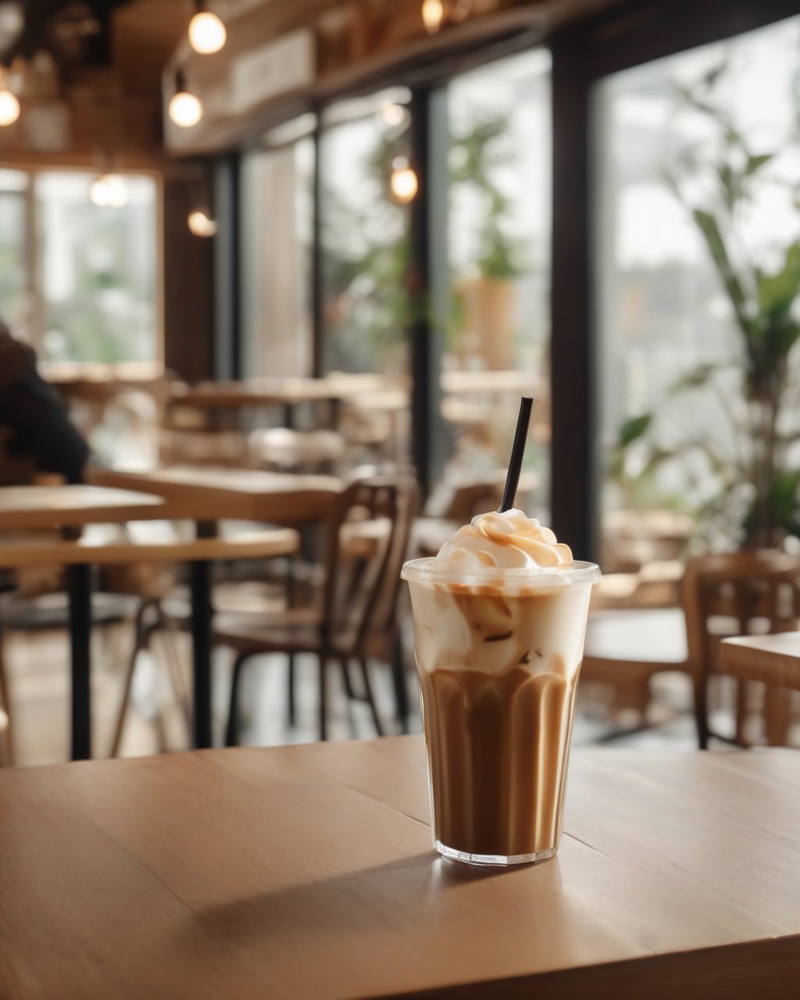

In [5]:
# 카페 이미지 생성 테스트
prompt = "A modern Korean cafe interior with iced coffee without whipping cream on a wooden table, natural lighting, warm atmosphere, professional photography, high quality, 4k"

image, filename = generator.generate(
    prompt=prompt,
    num_inference_steps=25
)

# 이미지 표시
display(image)

## 6. 테스트 2: 다양한 광고 시나리오

In [6]:
# 소상공인 광고 시나리오 정의
scenarios = [
    {
        "name": "비오는 날 우동집",
        "prompt": "A warm cozy Korean udon restaurant storefront on a rainy day, steaming hot udon bowl in focus, soft lighting, raindrops on window, inviting atmosphere, professional food photography, high quality, 4k"
    },
    {
        "name": "여름 카페 아이스커피",
        "prompt": "A refreshing iced americano coffee with ice cubes, modern minimalist cafe interior, bright summer sunlight, professional product photography, clean aesthetic, high quality, 4k"
    },
    {
        "name": "빵집 신제품",
        "prompt": "Freshly baked artisan bread and pastries display, warm bakery interior, golden hour lighting, appetizing food photography, rustic wooden table, high quality, 4k"
    }
]

print("="*60)
print("🎯 SDXL 광고 이미지 생성 테스트")
print("="*60 + "\n")

🎯 SDXL 광고 이미지 생성 테스트



[1/3] 비오는 날 우동집
------------------------------------------------------------
🎨 이미지 생성 중...
📝 프롬프트: A warm cozy Korean udon restaurant storefront on a rainy day, steaming hot udon bowl in focus, soft lighting, raindrops on window, inviting atmosphere, professional food photography, high quality, 4k
⚙️  설정: steps=25, guidance=7.5
📐 크기: 1024x1280



  0%|          | 0/25 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_082940.png



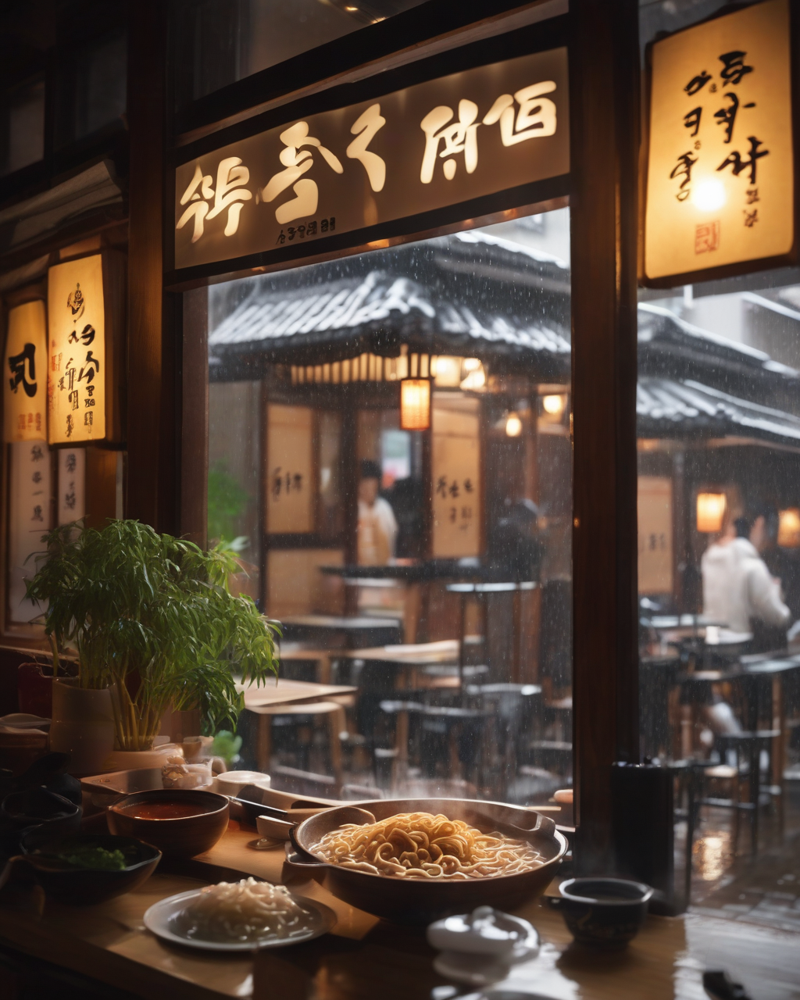


[2/3] 여름 카페 아이스커피
------------------------------------------------------------
🎨 이미지 생성 중...
📝 프롬프트: A refreshing iced americano coffee with ice cubes, modern minimalist cafe interior, bright summer sunlight, professional product photography, clean aesthetic, high quality, 4k
⚙️  설정: steps=25, guidance=7.5
📐 크기: 1024x1280



  0%|          | 0/25 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_083002.png



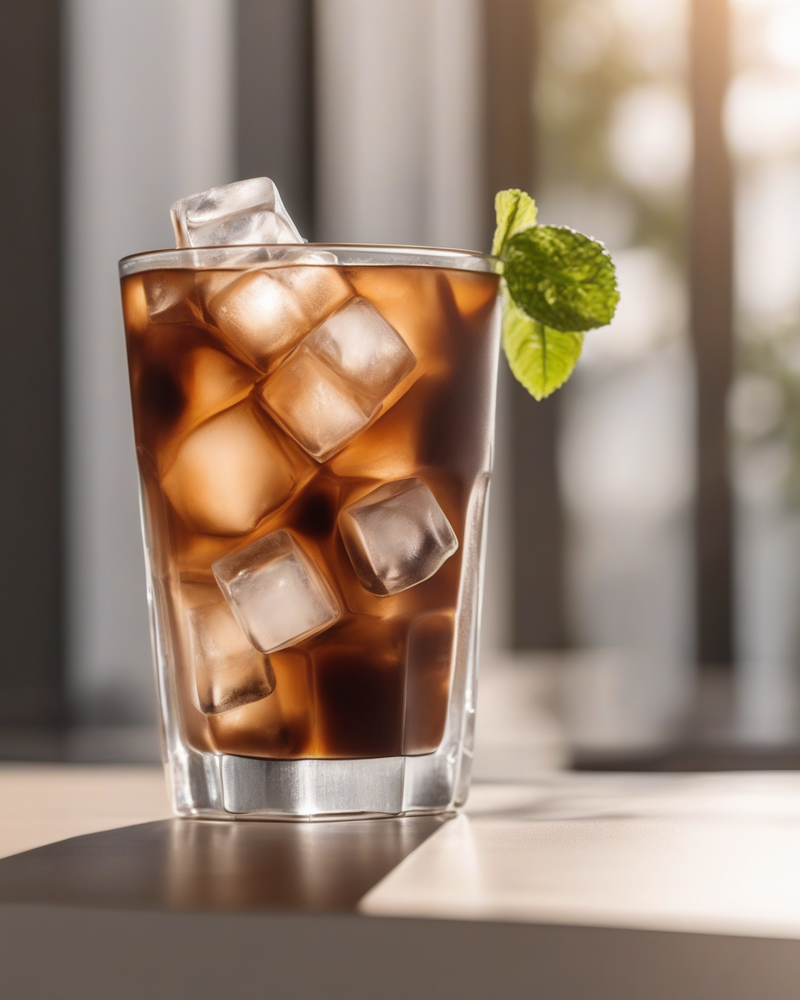


[3/3] 빵집 신제품
------------------------------------------------------------
🎨 이미지 생성 중...
📝 프롬프트: Freshly baked artisan bread and pastries display, warm bakery interior, golden hour lighting, appetizing food photography, rustic wooden table, high quality, 4k
⚙️  설정: steps=25, guidance=7.5
📐 크기: 1024x1280



  0%|          | 0/25 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_083023.png



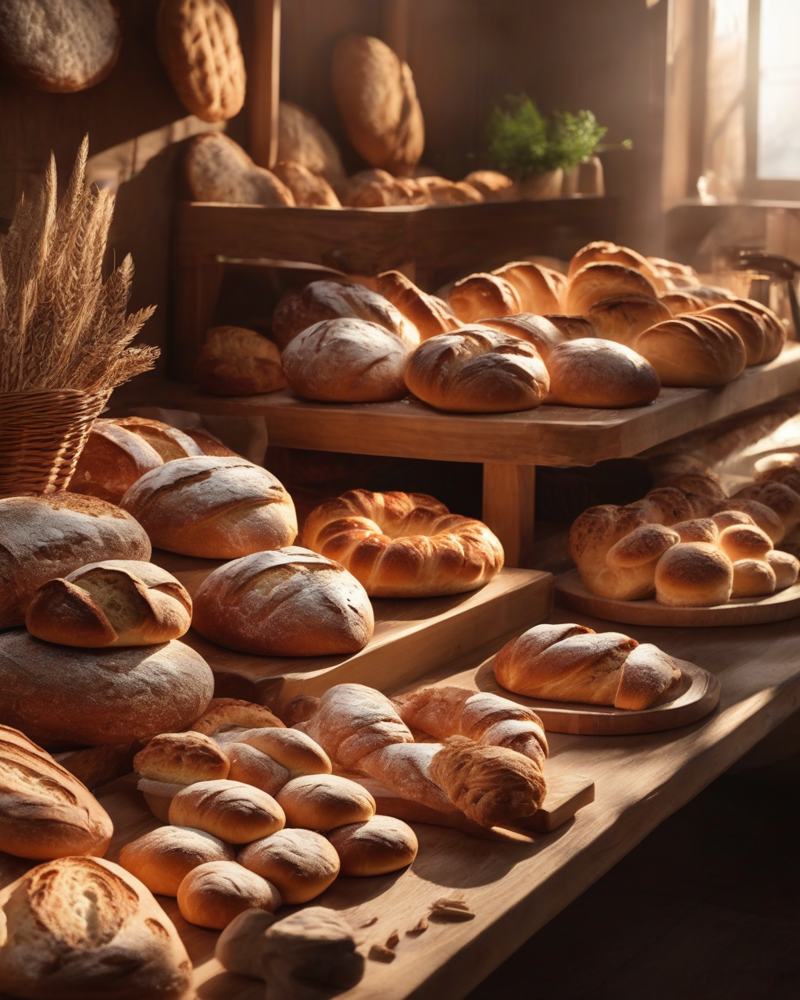

In [7]:
# 시나리오별 이미지 생성
results = []

for i, scenario in enumerate(scenarios, 1):
    print(f"[{i}/{len(scenarios)}] {scenario['name']}")
    print("-" * 60)

    image, filename = generator.generate(
        prompt=scenario['prompt'],
        num_inference_steps=25
    )

    results.append({
        "scenario": scenario['name'],
        "image": image,
        "file": filename
    })

    # 이미지 표시
    display(image)
    print()

## 7. 글자 생성 테스트


🎨 이미지 생성 중...
📝 프롬프트: A steaming bowl of udon noodles on a rustic wood table, rainy day outside the window, soft warm indoor lighting, cozy comforting mood, cinematic composition, restaurant promotional poster style, slight vignette, detailed steam, clear glossy broth, clean aesthetic, sharp focus on the noodles, shallow depth of field
⚙️  설정: steps=30, guidance=8.0
📐 크기: 1024x1280



  0%|          | 0/30 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_083145.png



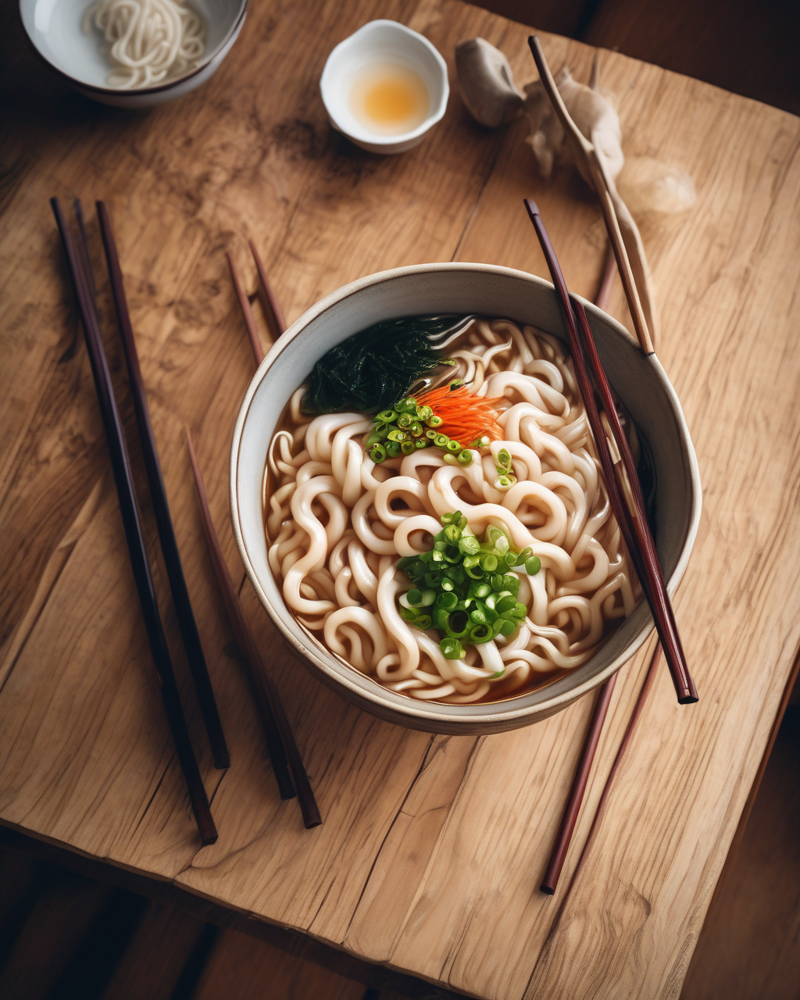

In [8]:
# 커스텀 프롬프트
custom_prompt = "A steaming bowl of udon noodles on a rustic wood table, rainy day outside the window, soft warm indoor lighting, cozy comforting mood, cinematic composition, restaurant promotional poster style, slight vignette, detailed steam, clear glossy broth, clean aesthetic, sharp focus on the noodles, shallow depth of field"

image, filename = generator.generate(
    prompt=custom_prompt,
    num_inference_steps=30,
    guidance_scale=8.0
)

display(image)

시험 삼아 "따끈한 우동"이라는 글자를 출력하게 해보았으나 글자는 생성되지만 이상한 형태의 글자들이 무작위호 생성되었습니다.

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', detailed noodles']
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', detailed noodles']


🎨 이미지 생성 중...
📝 프롬프트: steaming udon noodles with rising steam, cozy indoor rainy atmosphere, restaurant advertisement poster style, graphic design layout, big bold Korean lettering, the poster includes Korean text: 따끈한 우동, high readability, neat font, strong contrast, text placed at the top of the image, clean background behind text, warm color palette, glossy broth, detailed noodles
⚙️  설정: steps=30, guidance=8.0
📐 크기: 1024x1280



  0%|          | 0/30 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_083238.png



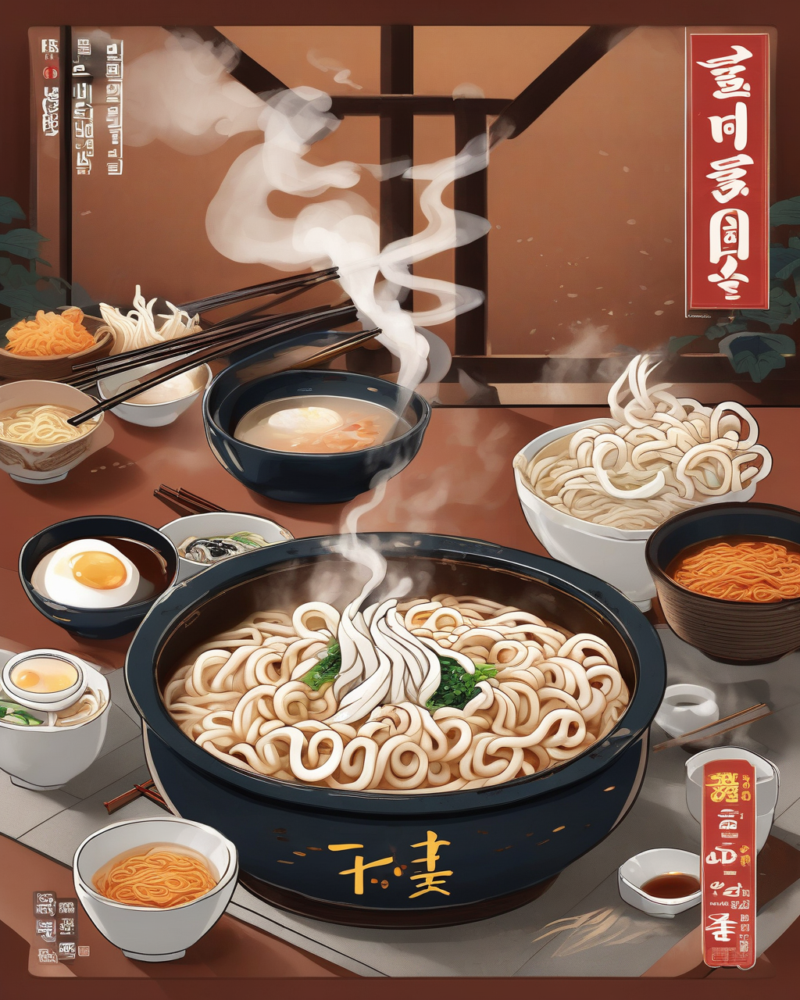

In [10]:
# 커스텀 프롬프트
custom_prompt = "steaming udon noodles with rising steam, cozy indoor rainy atmosphere, restaurant advertisement poster style, graphic design layout, big bold Korean lettering, the poster includes Korean text: 따끈한 우동, high readability, neat font, strong contrast, text placed at the top of the image, clean background behind text, warm color palette, glossy broth, detailed noodles"

image, filename = generator.generate(
    prompt=custom_prompt,
    num_inference_steps=30,
    guidance_scale=8.0
)

display(image)

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', detailed noodles']
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', detailed noodles']
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', detailed noodles']


🎨 이미지 생성 중...
📝 프롬프트: steaming udon noodles with rising steam, cozy indoor rainy atmosphere, restaurant advertisement poster style, graphic design layout, big bold Korean lettering, the poster includes Korean text: 따끈한 우동, high readability, neat font, strong contrast, text placed at the top of the image, clean background behind text, warm color palette, glossy broth, detailed noodles
⚙️  설정: steps=30, guidance=8.0
📐 크기: 1024x1280



  0%|          | 0/30 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_083304.png



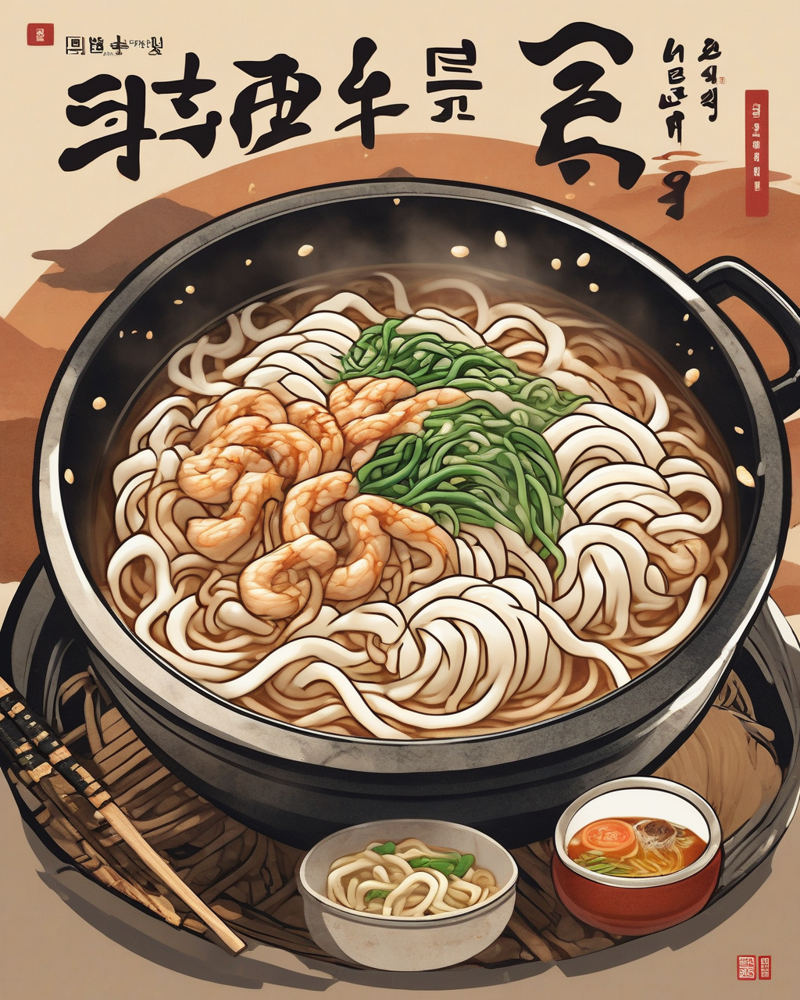

In [11]:
# 커스텀 프롬프트
custom_prompt = "steaming udon noodles with rising steam, cozy indoor rainy atmosphere, restaurant advertisement poster style, graphic design layout, big bold Korean lettering, the poster includes Korean text: 따끈한 우동, high readability, neat font, strong contrast, text placed at the top of the image, clean background behind text, warm color palette, glossy broth, detailed noodles"

image, filename = generator.generate(
    prompt=custom_prompt,
    num_inference_steps=30,
    guidance_scale=8.0
)

display(image)

포스터 위에 음식과 겹치지 않게 투명한 배경으로 문구 자리를 비우라는 네거티브 프롬프트를 입력했습니다. copy space 라는 표현은 SDXL에서 텍스트 삽입 공간을 확보하는 데 가장 잘 먹히는 키워드라고 합니다. 우동 위에 텍스트를 넣을 수 있는 빈 공간이 생겼지만 검은색 기둥이 텍스트를 넣는데 방해가 될 수 있을 것 같습니다.

🎨 이미지 생성 중...
📝 프롬프트: Steaming bowl of udon on a wooden table, cozy warm lighting, rainy window background, soft bokeh. Restaurant promotional poster style. Leave clean copy space at top, smooth plain background there, high contrast area for text.
⚙️  설정: steps=30, guidance=8.0
📐 크기: 1024x1280



  0%|          | 0/30 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_090406.png



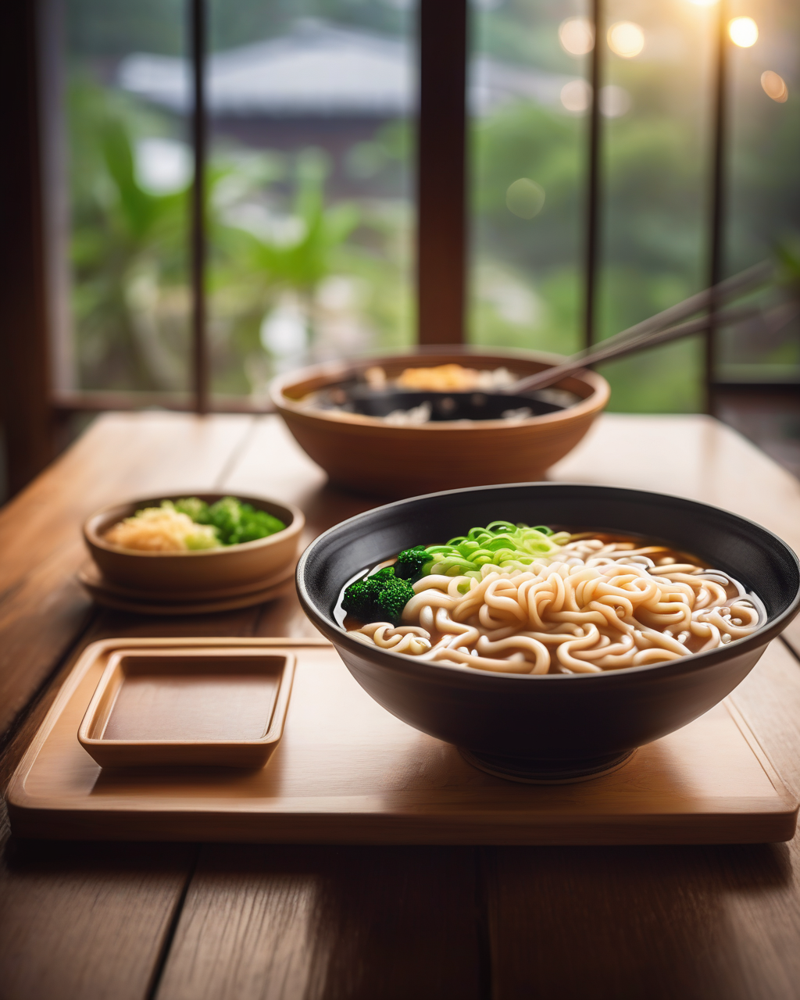

In [13]:
# 커스텀 프롬프트와 네거티브 프롬프트
main_prompt = "Steaming bowl of udon on a wooden table, cozy warm lighting, rainy window background, soft bokeh. Restaurant promotional poster style. Leave clean copy space at top, smooth plain background there, high contrast area for text."

negative_prompt = "no text, no letters, no watermark, no logo, no clutter, no objects in copy space, distorted shapes, artifacts"

image, filename = generator.generate(
    prompt=main_prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=30,
    guidance_scale=8.0
)

display(image)

🎨 이미지 생성 중...
📝 프롬프트: Steaming bowl of udon on a wooden table, cozy warm lighting, rainy window background, soft bokeh. Restaurant promotional poster style. Leave clean copy space at top, smooth plain background there, high contrast area for text.
⚙️  설정: steps=30, guidance=8.0
📐 크기: 1024x1280



  0%|          | 0/30 [00:00<?, ?it/s]

✅ 생성 완료!
📁 저장 위치: ../outputs/sdxl_20251110_091014.png



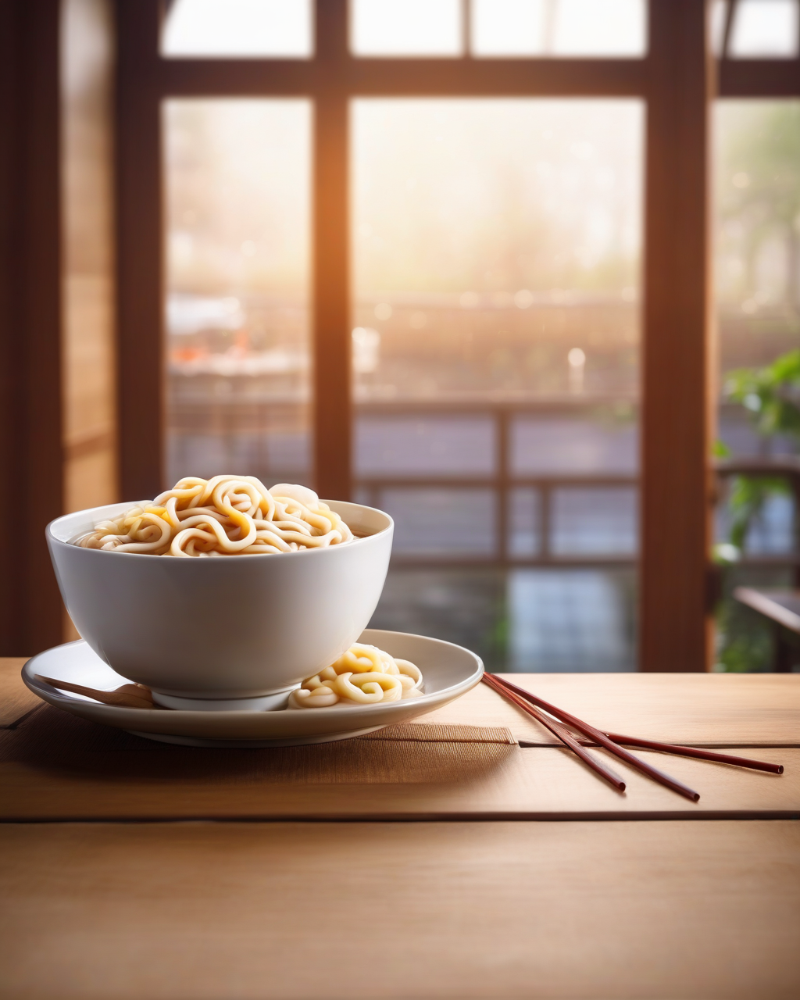

In [15]:
# 커스텀 프롬프트와 네거티브 프롬프트
main_prompt = "Steaming bowl of udon on a wooden table, cozy warm lighting, rainy window background, soft bokeh. Restaurant promotional poster style. Leave clean copy space at top, smooth plain background there, high contrast area for text."

negative_prompt = "no text, no letters, no watermark, no logo, no clutter, no objects, nothing hinders text in copy space, distorted shapes, artifacts"

image, filename = generator.generate(
    prompt=main_prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=30,
    guidance_scale=8.0
)

display(image)